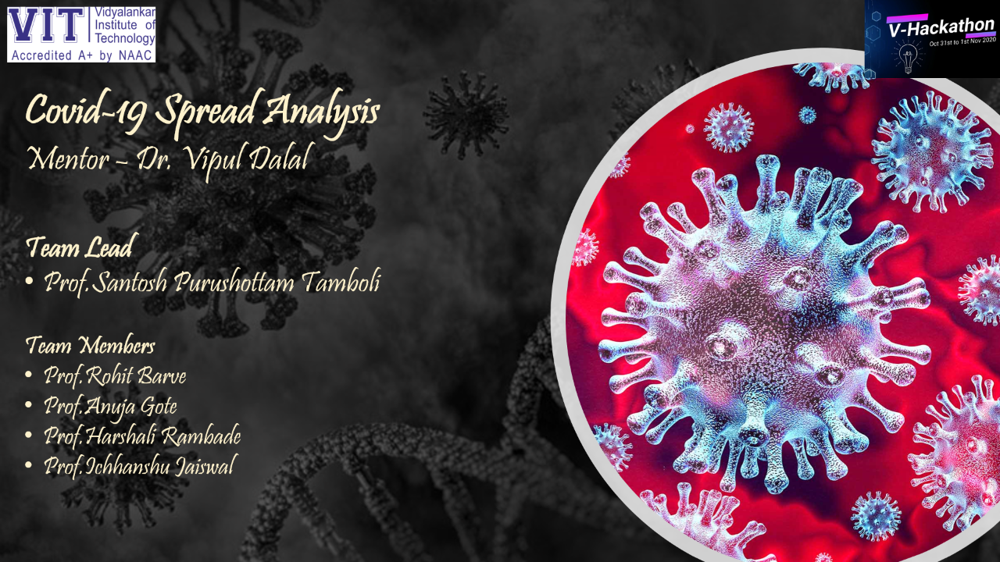

In [1]:
!pip install folium

You should consider upgrading via the 'c:\users\admin\anaconda3\python.exe -m pip install --upgrade pip' command.


In [2]:
!pip install plotly

You should consider upgrading via the 'c:\users\admin\anaconda3\python.exe -m pip install --upgrade pip' command.


In [3]:
import pandas as pd

import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as pff
from plotly.subplots import make_subplots

import folium

import matplotlib.pyplot as plt


import numpy as np
from datetime import timedelta


In [4]:
import plotly as py
py.offline.init_notebook_mode(connected=True)

# Covid - 19 Spread Analysis By Using matplotlib

In [5]:
daywise=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\daywise.csv", parse_dates=['Date'])
daywise

,Date,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,No. of Countries
0,2020-01-22,555,17,28,510,0,3.06,5.05,60.71,6
1,2020-01-23,654,18,30,606,99,2.75,4.59,60.00,8
2,2020-01-24,941,26,36,879,287,2.76,3.83,72.22,9
3,2020-01-25,1434,42,39,1353,493,2.93,2.72,107.69,11
4,2020-01-26,2118,56,52,2010,684,2.64,2.46,107.69,13
...,...,...,...,...,...,...,...,...,...,...
275,2020-09-05,26888773,879659,17928840,8080274,263315,3.27,66.68,4.91,188
276,2020-09-06,27110851,883428,18139070,8088353,222078,3.26,66.91,4.87,188
277,2020-09-07,27344651,892740,18337969,8113942,241753,3.26,67.06,4.87,188
278,2020-09-08,27586089,897679,18538832,8149578,241438,3.25,67.20,4.84,188


In [6]:
daywise.columns

Index(['Date', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'New Cases',
       'Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered',
       'No. of Countries'],
      dtype='object')

In [7]:
countrywise=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\countrywise.csv")
countrywise

,Country,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People,Confirmed last week,1 week change,1 week % increase
0,Afghanistan,38544,1420,31048,6076,24,3.68,80.55,4.57,38928341,990.0,40357,675,1.67
1,Albania,10704,322,6284,4098,151,3.01,58.71,5.12,2877800,3720.0,17651,2078,11.77
2,Algeria,47216,1581,33379,12256,278,3.35,70.69,4.74,43851043,1077.0,54829,1877,3.42
3,Andorra,1301,53,938,310,40,4.07,72.10,5.65,77265,16838.0,3623,787,21.72
4,Angola,3092,126,1245,1721,59,4.08,40.27,10.12,32866268,94.0,8049,1822,22.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,West Bank and Gaza,27919,192,18466,9261,556,0.69,66.14,1.04,4543126,6145.0,48129,3399,7.06
185,Western Sahara,10,1,8,1,0,10.00,80.00,12.50,597330,17.0,10,0,0.00
186,Yemen,1999,576,1209,214,5,28.81,60.48,47.64,29825968,67.0,2057,3,0.15
187,Zambia,13112,300,11839,973,160,2.29,90.29,2.53,18383956,713.0,15982,261,1.63


In [8]:
countrywise.columns

Index(['Country', 'Confirmed', 'Deaths', 'Recovered', 'Active', 'New Cases',
       'Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered',
       'Population', 'Cases / Million People', 'Confirmed last week',
       '1 week change', '1 week % increase'],
      dtype='object')

In [9]:
countrydaywise=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\country_daywise.csv", parse_dates=['Date'])
countrydaywise

,Date,Country,Confirmed,Deaths,Recovered,Active,New Cases,New Deaths,New Recovered
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0
1,2020-01-22,Albania,0,0,0,0,0,0,0
2,2020-01-22,Algeria,0,0,0,0,0,0,0
3,2020-01-22,Andorra,0,0,0,0,0,0,0
4,2020-01-22,Angola,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
52915,2020-09-09,West Bank and Gaza,27919,192,18466,9261,556,2,687
52916,2020-09-09,Western Sahara,10,1,8,1,0,0,0
52917,2020-09-09,Yemen,1999,576,1209,214,5,0,6
52918,2020-09-09,Zambia,13112,300,11839,973,160,3,52


In [10]:
countrydaywise.columns

Index(['Date', 'Country', 'Confirmed', 'Deaths', 'Recovered', 'Active',
       'New Cases', 'New Deaths', 'New Recovered'],
      dtype='object')

In [11]:
cnf=countrydaywise.groupby('Date').sum().reset_index()
cnf

,Date,Confirmed,Deaths,Recovered,Active,New Cases,New Deaths,New Recovered
0,2020-01-22,555,17,28,510,0,0,0
1,2020-01-23,654,18,30,606,99,1,2
2,2020-01-24,941,26,36,879,287,8,6
3,2020-01-25,1434,42,39,1353,493,16,3
4,2020-01-26,2118,56,52,2010,684,14,13
...,...,...,...,...,...,...,...,...
275,2020-10-23,42204005,1144147,28551998,12507860,506818,6954,206123
276,2020-10-24,42615063,1149784,28763265,12702014,411058,5637,211267
277,2020-10-25,42960217,1153725,28959620,12846872,345154,3941,196355
278,2020-10-26,43485415,1159397,29199046,13126972,525198,5672,239426


# Line graph for World wide Confirmed, Recovered, Death and Active cases

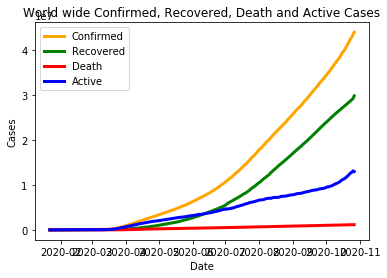

In [12]:
plt.title('World wide Confirmed, Recovered, Death and Active Cases')
plt.plot(cnf.Date,cnf.Confirmed, label='Confirmed',color='orange',linewidth=3)
plt.plot(cnf.Date,cnf.Recovered, label='Recovered',color='green',linewidth=3)
plt.plot(cnf.Date,cnf.Deaths, label='Death',color='red',linewidth=3)
plt.plot(cnf.Date,cnf.Active, label='Active',color='blue',linewidth=3)

plt.xlabel('Date')
plt.ylabel('Cases')
#plt.xticks(countrydaywise.Date[::30])

plt.legend()

plt.show()


### Conclusion: Number of confiremed cases drastically increases but recovery cases are also increases. Death cases are very low

# Scatter Plot

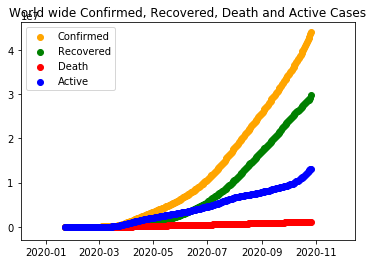

In [13]:
plt.title('World wide Confirmed, Recovered, Death and Active Cases')
plt.scatter(cnf.Date,cnf.Confirmed, label='Confirmed',color='orange')
plt.scatter(cnf.Date,cnf.Recovered, label='Recovered',color='green')
plt.scatter(cnf.Date,cnf.Deaths, label='Death',color='red')
plt.scatter(cnf.Date,cnf.Active, label='Active',color='blue')



plt.legend()

plt.show()

# Pie Chart

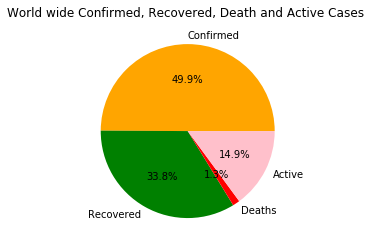

In [14]:
cf=cnf['Confirmed'].max()
rec=cnf['Recovered'].max()
dt=cnf['Deaths'].max()
act=cnf['Active'].max()
data=[cf,rec,dt,act]

plt.title('World wide Confirmed, Recovered, Death and Active Cases ')

plt.pie(data,labels=('Confirmed','Recovered','Deaths','Active'),colors=('orange','green','red','pink'),autopct='%1.1f%%')

plt.show()

# Bar Graph

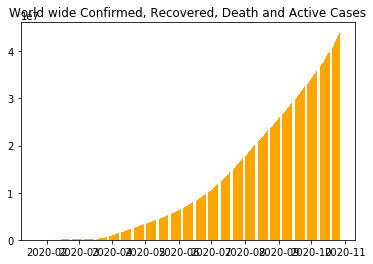

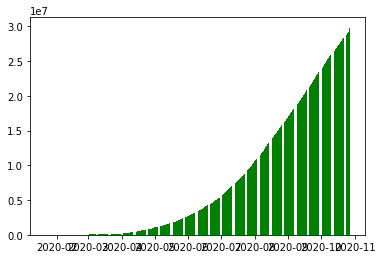

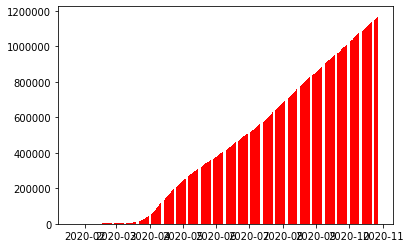

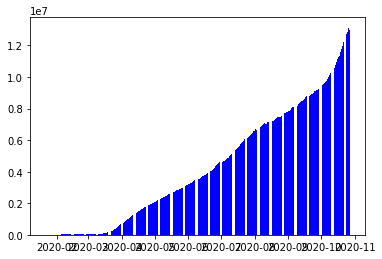

In [15]:
plt.title('World wide Confirmed, Recovered, Death and Active Cases')
plt.bar(cnf.Date,cnf.Confirmed, label='Confirmed',color='orange')
plt.show()
plt.bar(cnf.Date,cnf.Recovered, label='Recovered',color='green')
plt.show()
plt.bar(cnf.Date,cnf.Deaths, label='Death',color='red')
plt.show()
plt.bar(cnf.Date,cnf.Active, label='Active',color='blue')
plt.show()



# New Cases

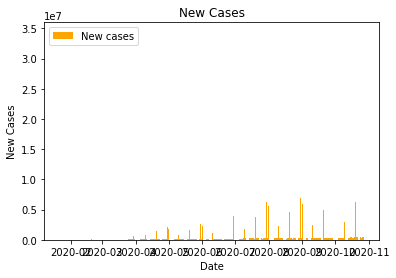

In [16]:
plt.title('New Cases')
plt.bar(cnf.Date,cnf['New Cases'], label='New cases',color='orange',linewidth=3)


plt.xlabel('Date')
plt.ylabel('New Cases')
#plt.xticks(countrydaywise.Date[::30])

plt.legend()

plt.show()


In [17]:
countrywise=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\countrywise.csv")
countrywise

,Country,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People,Confirmed last week,1 week change,1 week % increase
0,Afghanistan,38544,1420,31048,6076,24,3.68,80.55,4.57,38928341,990.0,40357,675,1.67
1,Albania,10704,322,6284,4098,151,3.01,58.71,5.12,2877800,3720.0,17651,2078,11.77
2,Algeria,47216,1581,33379,12256,278,3.35,70.69,4.74,43851043,1077.0,54829,1877,3.42
3,Andorra,1301,53,938,310,40,4.07,72.10,5.65,77265,16838.0,3623,787,21.72
4,Angola,3092,126,1245,1721,59,4.08,40.27,10.12,32866268,94.0,8049,1822,22.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,West Bank and Gaza,27919,192,18466,9261,556,0.69,66.14,1.04,4543126,6145.0,48129,3399,7.06
185,Western Sahara,10,1,8,1,0,10.00,80.00,12.50,597330,17.0,10,0,0.00
186,Yemen,1999,576,1209,214,5,28.81,60.48,47.64,29825968,67.0,2057,3,0.15
187,Zambia,13112,300,11839,973,160,2.29,90.29,2.53,18383956,713.0,15982,261,1.63


# Bar Graph for Confirmed, Recovered, Death, Active Cases for China, India, US, Japan

In [18]:
cnf=countrywise.query("Country in('India','US','China','Japan')")[::]
cnf

,Country,Confirmed,Deaths,Recovered,Active,New Cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People,Confirmed last week,1 week change,1 week % increase
36,China,90100,4733,84957,410,13,5.25,94.29,5.57,-2147483648,-42.0,91022,200,0.22
79,India,4465863,75062,3471783,919018,95735,1.68,77.74,2.16,-2147483648,-2080.0,7651107,339215,4.43
87,Japan,73264,1412,63734,8118,540,1.93,86.99,2.22,252643406,290.0,93895,4251,4.53
175,US,6366362,190853,2387479,3788030,33604,3.00,37.50,7.99,330541757,19260.0,8274604,502828,6.08


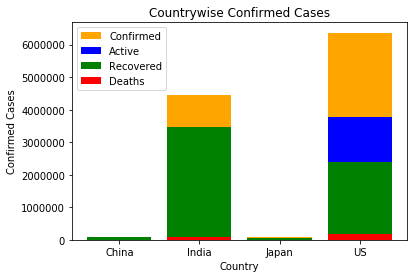

In [19]:
plt.title('Countrywise Confirmed Cases')

plt.bar(cnf.Country,cnf.Confirmed, label='Confirmed', color='orange')
plt.bar(cnf.Country,cnf.Active, label='Active',color='blue')
plt.bar(cnf.Country,cnf.Recovered, label='Recovered',color='green')
plt.bar(cnf.Country,cnf.Deaths, label='Deaths',color='red')


plt.xlabel('Country')
plt.ylabel('Confirmed Cases')

plt.legend()

plt.show()

# Covid - 19 Spread Analysis By Using plotly

In [20]:
world=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\covid_19_data.csv", parse_dates=['Date'])
world

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
1,2020-01-23,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
2,2020-01-24,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
3,2020-01-25,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
4,2020-01-26,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
84835,2020-10-23,NaN,Yemen,15.552727,48.516388,0,1354,0,-1354
84836,2020-10-24,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360
84837,2020-10-25,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360
84838,2020-10-26,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360


In [21]:
world['Province/State']=world['Province/State'].fillna("")
world

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.939110,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.939110,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.939110,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.939110,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.939110,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
84835,2020-10-23,,Yemen,15.552727,48.516388,0,1354,0,-1354
84836,2020-10-24,,Yemen,15.552727,48.516388,0,1360,0,-1360
84837,2020-10-25,,Yemen,15.552727,48.516388,0,1360,0,-1360
84838,2020-10-26,,Yemen,15.552727,48.516388,0,1360,0,-1360


In [22]:
world.columns

Index(['Date', 'Province/State', 'Country', 'Lat', 'Long', 'Confirmed',
       'Recovered', 'Deaths', 'Active'],
      dtype='object')

In [25]:
cnf=world.groupby('Date').sum()['Confirmed'].reset_index()
dt=world.groupby('Date').sum()['Deaths'].reset_index()
rec=world.groupby('Date').sum()['Recovered'].reset_index()
act=world.groupby('Date').sum()['Active'].reset_index()

# Scatter Plot

In [40]:
f=go.Figure()
f.add_trace(go.Scatter(x=cnf['Date'], y=cnf['Confirmed'],line=dict(color='orange'), name='Confirmed'))
f.add_trace(go.Scatter(x=cnf['Date'], y=rec['Recovered'],line=dict(color='green'),name='Recovered'))
f.add_trace(go.Scatter(x=cnf['Date'], y=dt['Deaths'],line=dict(color='red'),name='Deaths'))
f.add_trace(go.Scatter(x=cnf['Date'], y=act['Active'],line=dict(color='blue'),name='Active'))

f.update_layout(title='Covid-19 Spread analysis for world')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

# Benefits of plotly over matplotlib:
## Interactive
## Zoom-in, Zoom-out
## Can be save onto local computer for future purpose

In [45]:
world.describe()

count          84840
unique           280
top       2020-07-17
freq             303
Name: Date, dtype: object

# Bar Graph

In [73]:
f=go.Figure()
f.add_trace(go.Bar(x=cnf['Date'], y=cnf['Confirmed'],name='Confirmed',marker=dict(color='orange')))
f.add_trace(go.Bar(x=cnf['Date'], y=rec['Recovered'],name='Recovered',marker=dict(color='green')))
f.add_trace(go.Bar(x=cnf['Date'], y=dt['Deaths'],name='Deaths',marker=dict(color='red')))
f.add_trace(go.Bar(x=cnf['Date'], y=act['Active'],name='Active',marker=dict(color='blue')))

f.update_layout(title='Covid-19 Spread analysis for world')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

In [78]:
w=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\covid_19_data.csv", parse_dates=['Date'])
w

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
1,2020-01-23,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
2,2020-01-24,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
3,2020-01-25,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
4,2020-01-26,NaN,Afghanistan,33.939110,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
84835,2020-10-23,NaN,Yemen,15.552727,48.516388,0,1354,0,-1354
84836,2020-10-24,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360
84837,2020-10-25,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360
84838,2020-10-26,NaN,Yemen,15.552727,48.516388,0,1360,0,-1360


In [81]:
w['Province/State']=w['Province/State'].fillna("")
w

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.939110,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.939110,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.939110,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.939110,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.939110,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
84835,2020-10-23,,Yemen,15.552727,48.516388,0,1354,0,-1354
84836,2020-10-24,,Yemen,15.552727,48.516388,0,1360,0,-1360
84837,2020-10-25,,Yemen,15.552727,48.516388,0,1360,0,-1360
84838,2020-10-26,,Yemen,15.552727,48.516388,0,1360,0,-1360


In [79]:
w.columns

Index(['Date', 'Province/State', 'Country', 'Lat', 'Long', 'Confirmed',
       'Recovered', 'Deaths', 'Active'],
      dtype='object')

In [83]:
w.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84840 entries, 0 to 84839
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Date            84840 non-null  datetime64[ns]
 1   Province/State  84840 non-null  object        
 2   Country         84840 non-null  object        
 3   Lat             84840 non-null  float64       
 4   Long            84840 non-null  float64       
 5   Confirmed       84840 non-null  int64         
 6   Recovered       84840 non-null  int64         
 7   Deaths          84840 non-null  int64         
 8   Active          84840 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 5.8+ MB


In [84]:
w['Date']=w['Date'].astype(str)

# Density Heat Map for Covid cases across the world 

In [87]:
f=px.density_mapbox(w,lat='Lat',lon='Long',hover_name='Country', hover_data=['Confirmed','Recovered','Deaths','Active'],animation_frame='Date',radius=5,color_continuous_scale='Portland', zoom=0, height=800)
f.update_layout(title='Covid-19 Spread Analysis for World', mapbox_style='open-street-map',mapbox_center_lon=0)
f.show()

In [88]:
wdata=w.groupby('Date')['Confirmed','Recovered','Deaths','Active'].sum().reset_index()
wdata

C:\Users\admin\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Date,Confirmed,Recovered,Deaths,Active
0,2020-01-22,555,28,17,510
1,2020-01-23,654,30,18,606
2,2020-01-24,941,36,26,879
3,2020-01-25,1434,39,42,1353
4,2020-01-26,2118,52,56,2010
...,...,...,...,...,...
275,2020-10-23,42204005,28551998,1144147,12507860
276,2020-10-24,42615063,28763265,1149784,12702014
277,2020-10-25,42960217,28959620,1153725,12846872
278,2020-10-26,43485415,29199046,1159397,13126972


In [92]:
wdata=w.groupby('Date')['Confirmed','Recovered','Deaths','Active'].sum().reset_index()
df=wdata.melt(id_vars='Date', value_vars=['Confirmed', 'Recovered', 'Deaths','Active'],var_name='Case_Type',value_name='Count')
df

C:\Users\admin\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Date,Case_Type,Count
0,2020-01-22,Confirmed,555
1,2020-01-23,Confirmed,654
2,2020-01-24,Confirmed,941
3,2020-01-25,Confirmed,1434
4,2020-01-26,Confirmed,2118
...,...,...,...
1115,2020-10-23,Active,12507860
1116,2020-10-24,Active,12702014
1117,2020-10-25,Active,12846872
1118,2020-10-26,Active,13126972


# Area Plot for Covid-19 world wide cases

In [94]:
wdata=w.groupby('Date')['Confirmed','Recovered','Deaths','Active'].sum().reset_index()
df=wdata.melt(id_vars='Date', value_vars=['Confirmed', 'Recovered', 'Deaths','Active'],var_name='Case',value_name='Count')

f=px.area(df,x='Date',y='Count',height=800,color='Case',title='Covid-19 cases across world',color_discrete_sequence=['orange','green','red','blue'] )
f.update_layout(xaxis_rangeslider_visible=True)

f.show()

C:\Users\admin\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



# Covid-19 Spread Analysis for US

In [167]:
countrydaywise=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\country_daywise.csv",parse_dates=['Date'])
countrydaywise

,Date,Country,Confirmed,Deaths,Recovered,Active,New Cases,New Deaths,New Recovered
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0
1,2020-01-22,Albania,0,0,0,0,0,0,0
2,2020-01-22,Algeria,0,0,0,0,0,0,0
3,2020-01-22,Andorra,0,0,0,0,0,0,0
4,2020-01-22,Angola,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
52915,2020-09-09,West Bank and Gaza,27919,192,18466,9261,556,2,687
52916,2020-09-09,Western Sahara,10,1,8,1,0,0,0
52917,2020-09-09,Yemen,1999,576,1209,214,5,0,6
52918,2020-09-09,Zambia,13112,300,11839,973,160,3,52


In [168]:
us=countrydaywise.query('Country=="US"')[::]
us.sort_values(["Date"], axis=0,ascending=True, inplace=True) 
us
  

,Date,Country,Confirmed,Deaths,Recovered,Active,New Cases,New Deaths,New Recovered
175,2020-01-22,US,1,0,0,1,0,0,0
364,2020-01-23,US,1,0,0,1,0,0,0
553,2020-01-24,US,2,0,0,2,1,0,0
742,2020-01-25,US,2,0,0,2,0,0,0
931,2020-01-26,US,5,0,0,5,3,0,0
...,...,...,...,...,...,...,...,...,...
4900,2020-10-23,US,8492891,223975,3375427,4893489,83836,943,22371
5089,2020-10-24,US,8576762,224889,3406656,4945217,83871,914,31229
5278,2020-10-25,US,8637375,225229,3422878,4989268,60613,340,16222
5467,2020-10-26,US,8704192,225706,3460455,5018031,66817,477,37577


In [195]:
cnf=us.groupby('Date').sum()['Confirmed'].reset_index()
rec=us.groupby('Date').sum()['Recovered'].reset_index()
act=us.groupby('Date').sum()['Active'].reset_index()

In [196]:
f=go.Figure()
f.add_trace(go.Scatter(x=cnf['Date'], y=cnf['Confirmed'],line=dict(color='orange'), name='Confirmed'))
f.add_trace(go.Scatter(x=rec['Date'], y=rec['Recovered'],line=dict(color='green'),name='Recovered'))
f.add_trace(go.Scatter(x=act['Date'], y=act['Active'],line=dict(color='blue'),name='Active'))

f.update_layout(title='Covid-19 Spread analysis for US')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

# Covid-19 Spread Analysis for India

In [141]:
india=countrydaywise.query('Country=="India"')[::]
india.sort_values(["Date"], axis=0,ascending=True, inplace=True) 
india

,Date,Country,Confirmed,Deaths,Recovered,Active,New Cases,New Deaths,New Recovered
79,2020-01-22,India,0,0,0,0,0,0,0
268,2020-01-23,India,0,0,0,0,0,0,0
457,2020-01-24,India,0,0,0,0,0,0,0
646,2020-01-25,India,0,0,0,0,0,0,0
835,2020-01-26,India,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...
4804,2020-10-23,India,7814682,117956,7016046,680680,53370,650,67549
4993,2020-10-24,India,7864811,118534,7078123,668154,50129,578,62077
5182,2020-10-25,India,7909959,119014,7137228,653717,45148,480,59105
5371,2020-10-26,India,7946429,119502,7201070,625857,36470,488,63842


In [142]:
cnf=india.groupby('Date').sum()['Confirmed'].reset_index()
rec=india.groupby('Date').sum()['Recovered'].reset_index()
dt=india.groupby('Date').sum()['Deaths'].reset_index()
act=india.groupby('Date').sum()['Active'].reset_index()

In [144]:
f=go.Figure()
f.add_trace(go.Scatter(x=cnf['Date'], y=cnf['Confirmed'],line=dict(color='orange'), name='Confirmed'))
f.add_trace(go.Scatter(x=rec['Date'], y=rec['Recovered'],line=dict(color='green'),name='Recovered'))
f.add_trace(go.Scatter(x=dt['Date'], y=dt['Deaths'],line=dict(color='red'),name='Deaths'))
f.add_trace(go.Scatter(x=act['Date'], y=act['Active'],line=dict(color='blue'),name='Active'))

f.update_layout(title='Covid-19 Spread analysis for India')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

In [145]:
india=pd.read_csv(r"F:\2020\2020 Online\Anaconda\Covid19\covid_19_india.csv",parse_dates=['Date'])
india

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,3,2020-01-02,6:00 PM,Kerala,2,0,0,0,2
3,4,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,5,2020-03-02,6:00 PM,Kerala,3,0,0,0,3
...,...,...,...,...,...,...,...,...,...
7781,7782,2020-10-27,8:00 AM,Telengana,-,-,213466,1315,232671
7782,7783,2020-10-27,8:00 AM,Tripura,-,-,28153,344,30293
7783,7784,2020-10-27,8:00 AM,Uttarakhand,-,-,55663,1001,60744
7784,7785,2020-10-27,8:00 AM,Uttar Pradesh,-,-,438521,6904,472077


In [146]:
india.sort_values(["Date"], axis=0,ascending=True, inplace=True) 
india

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
2,3,2020-01-02,6:00 PM,Kerala,2,0,0,0,2
31,32,2020-01-03,6:00 PM,Kerala,3,0,0,0,3
557,558,2020-01-04,7:30 PM,West Bengal,-,-,6,3,37
556,557,2020-01-04,7:30 PM,Uttar Pradesh,-,-,14,2,103
555,556,2020-01-04,7:30 PM,Uttarakhand,-,-,2,0,7
...,...,...,...,...,...,...,...,...,...
7238,7239,2020-12-10,8:00 AM,Himachal Pradesh,-,-,14471,250,17408
7239,7240,2020-12-10,8:00 AM,Jammu and Kashmir,-,-,71845,1322,83633
7240,7241,2020-12-10,8:00 AM,Jharkhand,-,-,83571,787,92525
7242,7243,2020-12-10,8:00 AM,Kerala,-,-,191798,1003,289202


In [160]:
cnf=india.groupby('State/UnionTerritory').max()['Confirmed'].reset_index()
cur=india.groupby('State/UnionTerritory').max()['Cured'].reset_index()
dt=india.groupby('State/UnionTerritory').max()['Deaths'].reset_index()

# Scatter Plot for Confirmed, Cured and Death cases State-wise

In [161]:
f=go.Figure()
f.add_trace(go.Scatter(x=cnf['State/UnionTerritory'], y=cnf['Confirmed'],line=dict(color='orange'), name='Confirmed'))
f.add_trace(go.Scatter(x=cur['State/UnionTerritory'], y=cur['Cured'],line=dict(color='green'),name='Cured'))
f.add_trace(go.Scatter(x=dt['State/UnionTerritory'], y=dt['Deaths'],line=dict(color='red'),name='Deaths'))


f.update_layout(title='Covid-19 Spread analysis for India')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

# Conclusion:
### Maharashtra at position 1 for Covid cases followed by Karnataka, Andhra Pradhesh and Tamil Nadu..
### It is possible to analyze without actual count of covid cases which is the biggest benefit of data visualization

# Bar Graph for Confirmed, Cured and Death cases State-wise

In [164]:
f=go.Figure()
f.add_trace(go.Bar(x=cnf['State/UnionTerritory'], y=cnf['Confirmed'],name='Confirmed',marker=dict(color='orange')))
f.add_trace(go.Bar(x=cur['State/UnionTerritory'], y=cur['Cured'],name='Cured',marker=dict(color='green')))
f.add_trace(go.Bar(x=dt['State/UnionTerritory'], y=dt['Deaths'],name='Deaths',marker=dict(color='red')))


f.update_layout(title='Covid-19 Spread analysis for India')
f.update_layout(xaxis=dict(title='Date'),yaxis=dict(title='Cases'))

f.show()

# India Covid-19 Confirmed, Cured and Death cases using Treemap

In [180]:
cnf=india.groupby('State/UnionTerritory').max()['Confirmed'].reset_index()
cnf

,State/UnionTerritory,Confirmed
0,Andaman and Nicobar Islands,4253
1,Andhra Pradesh,808924
2,Arunachal Pradesh,14391
3,Assam,204386
4,Bihar,212355
5,Cases being reassigned to states,9265
6,Chandigarh,14085
7,Chhattisgarh,177608
8,Dadar Nagar Haveli,26
9,Dadra and Nagar Haveli and Daman and Diu,3228


In [185]:
cnf=india.groupby('State/UnionTerritory').max()['Confirmed'].reset_index()

f= px.treemap(cnf, path=['State/UnionTerritory'], values='Confirmed', height=600, width=800, title='State-wise Confirmed cases')


f.show()

In [190]:
cur=india.groupby('State/UnionTerritory').max()['Cured'].reset_index()
cur

,State/UnionTerritory,Cured
0,Andaman and Nicobar Islands,3997
1,Andhra Pradesh,773548
2,Arunachal Pradesh,12182
3,Assam,188587
4,Bihar,201942
5,Cases being reassigned to states,0
6,Chandigarh,13230
7,Chhattisgarh,153654
8,Dadar Nagar Haveli,2
9,Dadra and Nagar Haveli and Daman and Diu,3176


In [191]:

f= px.treemap(cur, path=['State/UnionTerritory'], values='Cured', height=600, width=800, title='State-wise Cured cases')


f.show()

In [193]:
dt=india.groupby('State/UnionTerritory').max()['Deaths'].reset_index()

f= px.treemap(dt, path=['State/UnionTerritory'], values='Deaths', height=600, width=800, title='State-wise Death cases')


f.show()

# India Covid-19 Confirmed, Cured and Death cases using Pie-chart

In [209]:
cnf=india.groupby('State/UnionTerritory').max()['Confirmed'].reset_index()
f = px.pie(cnf, values = 'Confirmed',names='State/UnionTerritory', height=600,title='Confirmed cases State-wise')
f.update_traces(textposition='inside', textinfo='percent+label')

f.show()

In [207]:
cur=india.groupby('State/UnionTerritory').max()['Cured'].reset_index()
f = px.pie(cur, values = 'Cured',names='State/UnionTerritory', height=600, title='Cured cases State-wise')
f.update_traces(textposition='inside', textinfo='percent+label')

f.show()

In [206]:
dt=india.groupby('State/UnionTerritory').max()['Deaths'].reset_index()
f = px.pie(dt, values = 'Deaths',names='State/UnionTerritory', height=600, title='Death cases State-wise')
f.update_traces(textposition='inside', textinfo='percent+label')

f.show()

# References:
### [1] https://www.kaggle.com/pritamguha31/covid-19-in-india?select=StatewiseTestingDetails.csv
### [2] https://plotly.com/python/plot-data-from-csv/
### [3] http://www.learningaboutelectronics.com/Articles/How-to-plot-a-graph-with-matplotlib-from-data-from-a-CSV-file-using-the-CSV-module-in-Python.php
### [4] https://python-graph-gallery.com/11-grouped-barplot/
### [5] https://stackoverflow.com/questions/43397942/how-to-filter-csv-data-by-applying-conditions-on-certain-columns-in-python
### [6] https://www.pythonprogramming.in/how-to-pie-chart-with-different-color-themes-in-matplotlib.html
### [7] https://matplotlib.org/3.1.0/gallery/pie_and_polar_charts/pie_features.html#sphx-glr-gallery-pie-and-polar-charts-pie-features-py
### [8] https://www.geeksforgeeks.org/python-pandas-dataframe-sort_values-set-2/


# Thank You